In [ ]:
import pandas as pd
import numpy as np
import plotly.graph_objects as go
import plotly.express as px

for i, day in enumerate([-1, 0, 1]):
    file_name = f"./round-2-island-data-bottle/prices_round_2_day_{day}.csv"
    df_tmp = pd.read_csv(file_name, sep=';')
    df_tmp['day'] = day
    if i > 0:
        df = pd.concat([df, df_tmp])
    else:
        df = df_tmp
df = df.reset_index(drop=True)

In [86]:
print(df.head(100))

    day  timestamp         product  bid_price_1  bid_volume_1  bid_price_2  \
0    -1          0      CROISSANTS         4304           112          NaN   
1    -1          0            JAMS         6670            66       6669.0   
2    -1          0       SQUID_INK         2005             1       2002.0   
3    -1          0  PICNIC_BASKET1        59284            20      59283.0   
4    -1          0  PICNIC_BASKET2        30606            20      30605.0   
..  ...        ...             ...          ...           ...          ...   
95   -1       1100            JAMS         6673            95       6672.0   
96   -1       1200      CROISSANTS         4305           116          NaN   
97   -1       1200            JAMS         6673            79       6672.0   
98   -1       1200       SQUID_INK         2006            21          NaN   
99   -1       1200  PICNIC_BASKET2        30619            46          NaN   

    bid_volume_2  bid_price_3  bid_volume_3  ask_price_1  ask_v

In [120]:
df_CROISSANTS = df[df['product'] == 'CROISSANTS'].reset_index(drop=True).copy()
df_JAMS = df[df['product'] == 'JAMS'].reset_index(drop=True).copy()
df_DJEMBES = df[df['product'] == 'DJEMBES'].reset_index(drop=True).copy()
df_PICNIC_BASKET1  = df[df['product'] == 'PICNIC_BASKET1'].reset_index(drop=True).copy()
df_PICNIC_BASKET2  = df[df['product'] == 'PICNIC_BASKET2'].reset_index(drop=True).copy()
df_CROISSANTS['swmid'] = (df_CROISSANTS['bid_price_1'] * df_CROISSANTS['ask_volume_1'] + df_CROISSANTS['ask_price_1'] * df_CROISSANTS['bid_volume_1']) / (df_CROISSANTS['ask_volume_1'] + df_CROISSANTS['bid_volume_1'])
df_JAMS['swmid'] = (df_JAMS['bid_price_1'] * df_JAMS['ask_volume_1'] + df_JAMS['ask_price_1'] * df_JAMS['bid_volume_1']) / (df_JAMS['ask_volume_1'] + df_JAMS['bid_volume_1'])
df_DJEMBES['swmid'] = (df_DJEMBES['bid_price_1'] * df_DJEMBES['ask_volume_1'] + df_DJEMBES['ask_price_1'] * df_DJEMBES['bid_volume_1']) / (df_DJEMBES['ask_volume_1'] + df_DJEMBES['bid_volume_1'])
df_PICNIC_BASKET1 ['swmid'] = (df_PICNIC_BASKET1 ['bid_price_1'] * df_PICNIC_BASKET1 ['ask_volume_1'] + df_PICNIC_BASKET1 ['ask_price_1'] * df_PICNIC_BASKET1 ['bid_volume_1']) / (df_PICNIC_BASKET1 ['ask_volume_1'] + df_PICNIC_BASKET1 ['bid_volume_1'])
df_PICNIC_BASKET2 ['swmid'] = (df_PICNIC_BASKET2 ['bid_price_1'] * df_PICNIC_BASKET2 ['ask_volume_1'] + df_PICNIC_BASKET2 ['ask_price_1'] * df_PICNIC_BASKET2 ['bid_volume_1']) / (df_PICNIC_BASKET2 ['ask_volume_1'] + df_PICNIC_BASKET2 ['bid_volume_1'])
df_synthetic_1 = pd.DataFrame({
    'day': df_CROISSANTS['day'].to_numpy(),
    'timestamp': df_CROISSANTS['timestamp'].to_numpy(),
    'bid_price_1': df_CROISSANTS['bid_price_1'].to_numpy() * 6 + df_JAMS['bid_price_1'].to_numpy() * 3 + df_DJEMBES['bid_price_1'].to_numpy(),
    'bid_volume_1': np.min(np.array([df_CROISSANTS['bid_volume_1'].to_numpy() / 6, df_JAMS['bid_volume_1'].to_numpy() / 3, df_DJEMBES['bid_volume_1'].to_numpy()]), axis=0),
    'ask_price_1': df_CROISSANTS['ask_price_1'].to_numpy() * 6 + df_JAMS['ask_price_1'].to_numpy() * 3 + df_DJEMBES['ask_price_1'].to_numpy(),
    'ask_volume_1': np.min(np.array([df_CROISSANTS['ask_volume_1'].to_numpy() / 6, df_JAMS['ask_volume_1'].to_numpy() / 3, df_DJEMBES['ask_volume_1'].to_numpy()]), axis=0),
    'mid_price':  df_CROISSANTS['mid_price'].to_numpy() * 6 + df_JAMS['mid_price'].to_numpy() * 3 + df_DJEMBES['mid_price'].to_numpy(),
    'swmid': df_CROISSANTS['swmid'].to_numpy() * 6 + df_JAMS['swmid'].to_numpy() * 3 + df_DJEMBES['swmid'].to_numpy()
    })

df_synthetic_2 = pd.DataFrame({
    'day': df_CROISSANTS['day'].to_numpy(),
    'timestamp': df_CROISSANTS['timestamp'].to_numpy(),
    'bid_price_1': df_CROISSANTS['bid_price_1'].to_numpy() * 4 + df_JAMS['bid_price_1'].to_numpy() * 2,
    'bid_volume_1': np.min(np.array([df_CROISSANTS['bid_volume_1'].to_numpy() / 4, df_JAMS['bid_volume_1'].to_numpy() / 2]), axis=0),
    'ask_price_1': df_CROISSANTS['ask_price_1'].to_numpy() * 4 + df_JAMS['ask_price_1'].to_numpy() * 2,
    'ask_volume_1': np.min(np.array([df_CROISSANTS['ask_volume_1'].to_numpy() / 4, df_JAMS['ask_volume_1'].to_numpy() / 2]), axis=0),
    'mid_price':  df_CROISSANTS['mid_price'].to_numpy() * 4 + df_JAMS['mid_price'].to_numpy() * 2,
    'swmid': df_CROISSANTS['swmid'].to_numpy() * 4 + df_JAMS['swmid'].to_numpy() * 2,
    })


In [121]:

print(df_synthetic_1.head(10))


   day  timestamp  bid_price_1  bid_volume_1  ask_price_1  ask_volume_1  \
0   -1          0        59284     18.666667        59294     18.666667   
1   -1        100        59283     22.166667        59294     22.166667   
2   -1        200        59284     18.333333        59297     18.333333   
3   -1        300        59286     19.666667        59300     19.666667   
4   -1        400        59295     23.666667        59308     23.666667   
5   -1        500        59296     22.500000        59309     22.500000   
6   -1        600        59302     21.000000        59312     21.000000   
7   -1        700        59300     18.166667        59313      6.833333   
8   -1        800        59303     17.833333        59313      5.833333   
9   -1        900        59309      7.666667        59322     21.000000   

   mid_price         swmid  
0    59289.0  59289.000000  
1    59288.5  59288.500000  
2    59290.5  59290.281690  
3    59293.0  59293.000000  
4    59301.5  59301.500000  


In [122]:
print(df_synthetic_2.head())


   day  timestamp  bid_price_1  bid_volume_1  ask_price_1  ask_volume_1  \
0   -1          0        30556         28.00        30562         28.00   
1   -1        100        30556         33.25        30562         33.25   
2   -1        200        30556         27.50        30564         27.50   
3   -1        300        30558         29.50        30566         29.50   
4   -1        400        30562         35.50        30570         35.50   

   mid_price    swmid  
0    30559.0  30559.0  
1    30559.0  30559.0  
2    30560.0  30560.0  
3    30562.0  30562.0  
4    30566.0  30566.0  


In [125]:
fig = go.Figure()
df_PICNIC_BASKET1['swmid'] = (df_PICNIC_BASKET1['bid_price_1'] * df_PICNIC_BASKET1 ['ask_volume_1'] + df_PICNIC_BASKET1 ['ask_price_1'] * df_PICNIC_BASKET1 ['bid_volume_1']) / (df_PICNIC_BASKET1 ['ask_volume_1'] + df_PICNIC_BASKET1 ['bid_volume_1'])
fig.add_trace(go.Scatter(x=df_PICNIC_BASKET1.index, y=df_PICNIC_BASKET1['swmid'], mode='lines', name='Gift Basket Price', line=dict(color='blue')))
fig.update_layout(title_text="Gift Basket Price")
fig.update_xaxes(title_text="Index")
fig.update_yaxes(title_text="Price")
fig.show()


In [126]:
from plotly.subplots import make_subplots

fig = make_subplots(specs=[[{"secondary_y": True}]])
# fig.add_trace(go.Scatter(x=df_synthetic['timestamp'], y=df_synthetic['swmid'] + 370, mode='lines', name='Synthetic SWMID', line=dict(color='green')))
fig.add_trace(go.Scatter(x=df_PICNIC_BASKET1.index, y=df_PICNIC_BASKET1['swmid'], mode='lines', name='Gift Basket SWMID', line=dict(color='blue')), secondary_y=False)
fig.add_trace(go.Scatter(x=df_synthetic_1.index, y=df_synthetic_1['swmid'], mode='lines', name='Synthetic SWMID', line=dict(color='red')), secondary_y=True)
fig.update_layout(title_text="Synthetic and Gift Basket SWMID")
fig.update_xaxes(title_text="Timestamp")
fig.update_yaxes(title_text="SWMID", secondary_y=False)
fig.update_yaxes(title_text="Synthetic SWMID", secondary_y=True)
fig.show()




In [127]:
fig = go.Figure()
spread = df_PICNIC_BASKET1['swmid'].to_numpy() - df_synthetic_1['swmid'].to_numpy()
fig.add_trace(go.Scatter(x=df_synthetic_1.index, y=spread, mode='lines', name='Spread', line=dict(color='blue')))
fig.update_layout(title_text="Spread between Gift Basket and Synthetic SWMID")

In [128]:
print(spread.mean(), spread.std())

48.77785696398906 85.11972310796634


In [10]:
test = {1:2, 3:4, 4:3}
sorted(test.items(), key=lambda x: x[0])

[(1, 2), (3, 4), (4, 3)]

In [129]:
fig = go.Figure()
spread = df_PICNIC_BASKET1['swmid'].to_numpy() - df_synthetic_1['swmid'].to_numpy()
# fig.add_trace(go.Scatter(x=df_synthetic['timestamp'], y=spread, mode='lines', name='Difference', line=dict(color='red')))
z_score = (spread - spread.mean()) / spread.std()
fig.add_trace(go.Scatter(x=df_synthetic_1.index, y=z_score, mode='lines', name='Z Score', line=dict(color='blue')))
fig.update_layout(title_text="Z Score of the Spread")

fig.show()


In [130]:
fig = go.Figure()
spread = df_PICNIC_BASKET2['swmid'].to_numpy() - df_synthetic_2['swmid'].to_numpy()
fig.add_trace(go.Scatter(x=df_synthetic_1.index, y=spread, mode='lines', name='Spread', line=dict(color='blue')))
fig.update_layout(title_text="Spread between Gift Basket 2 and Synthetic SWMID")

In [102]:
print(spread.mean(), spread.std())

30.233664373870205 59.8536533385596


In [131]:
fig = go.Figure()
spread = df_PICNIC_BASKET2['swmid'].to_numpy() - df_synthetic_2['swmid'].to_numpy()
# fig.add_trace(go.Scatter(x=df_synthetic['timestamp'], y=spread, mode='lines', name='Difference', line=dict(color='red')))
z_score = (spread - spread.mean()) / spread.std()
fig.add_trace(go.Scatter(x=df_synthetic_2.index, y=z_score, mode='lines', name='Z Score', line=dict(color='blue')))
fig.update_layout(title_text="Z Score of the Spread")

fig.show()

Spreads aren't zero-mean. The mean for spread for each day is not stable.

In [132]:
df_synthetic_3 = pd.DataFrame({
    'day': df_CROISSANTS['day'].to_numpy(),
    'timestamp': df_CROISSANTS['timestamp'].to_numpy(),
    'bid_price_1': df_PICNIC_BASKET2['bid_price_1'].to_numpy() * 1.5 + df_DJEMBES['bid_price_1'].to_numpy(),
    'bid_volume_1': np.min(np.array([df_PICNIC_BASKET2['bid_volume_1'].to_numpy() / 1.5, df_DJEMBES['bid_volume_1'].to_numpy()]), axis=0),
    'ask_price_1': df_PICNIC_BASKET2['ask_price_1'].to_numpy() * 1.5 + df_DJEMBES['ask_price_1'].to_numpy(),
    'ask_volume_1': np.min(np.array([df_PICNIC_BASKET2['ask_volume_1'].to_numpy() / 1.5, df_DJEMBES['ask_volume_1'].to_numpy()]), axis=0),
    'mid_price':  df_PICNIC_BASKET2['mid_price'].to_numpy() * 1.5 + df_DJEMBES['mid_price'].to_numpy(),
    'swmid': df_PICNIC_BASKET2['swmid'].to_numpy() * 1.5 + df_DJEMBES['swmid'].to_numpy()
    })


In [133]:
fig = make_subplots(specs=[[{"secondary_y": True}]])
# fig.add_trace(go.Scatter(x=df_synthetic['timestamp'], y=df_synthetic['swmid'] + 370, mode='lines', name='Synthetic SWMID', line=dict(color='green')))
fig.add_trace(go.Scatter(x=df_PICNIC_BASKET1.index, y=df_PICNIC_BASKET1 ['swmid'], mode='lines', name='Gift Basket SWMID', line=dict(color='blue')), secondary_y=False)
fig.add_trace(go.Scatter(x=df_synthetic_3.index, y=df_synthetic_3['swmid'], mode='lines', name='Synthetic SWMID', line=dict(color='red')), secondary_y=True)
fig.update_layout(title_text="Synthetic and Gift Basket SWMID")
fig.update_xaxes(title_text="Timestamp")
fig.update_yaxes(title_text="SWMID", secondary_y=False)
fig.update_yaxes(title_text="Synthetic SWMID", secondary_y=True)
fig.show()

In [134]:
fig = go.Figure()
spread = df_PICNIC_BASKET1['swmid'].to_numpy() - df_synthetic_3['swmid'].to_numpy()
fig.add_trace(go.Scatter(x=df_synthetic_1.index, y=spread, mode='lines', name='Spread', line=dict(color='blue')))
fig.update_layout(title_text="Spread between Gift Basket 1 and Synthetic 3 SWMID")

In [135]:
print(spread.mean(), spread.std())

3.427360403183699 93.53956820905707


In [136]:
fig = go.Figure()
spread = df_PICNIC_BASKET1['swmid'].to_numpy() - df_synthetic_3['swmid'].to_numpy()
# fig.add_trace(go.Scatter(x=df_synthetic['timestamp'], y=spread, mode='lines', name='Difference', line=dict(color='red')))
z_score = (spread - spread.mean()) / spread.std()
fig.add_trace(go.Scatter(x=df_synthetic_1.index, y=z_score, mode='lines', name='Z Score', line=dict(color='blue')))
fig.update_layout(title_text="Z Score of the Spread")

fig.show()


In [137]:
from tqdm import tqdm
spread_market = pd.DataFrame({'timestamp': df_synthetic_1['timestamp'].to_numpy(), 'spread_z': z_score, 'swmid': df_PICNIC_BASKET1 ['swmid'].to_numpy() - df_synthetic_1['swmid'].to_numpy()},
                             index=df_synthetic_1.index)

thresh1 = 0.9
thresh2 = 1.8
position1 = 30
position2 = 40
def cross_spread(cash, quantity):
    return cash - abs(quantity) * 10

def backtest(thresh1, thresh2, position1, position2):
    cash = 0
    position = 0
    pnl_hist = []
    position_hist = []
    cash_hist = []
    for index, row in spread_market.iterrows():
        if index == 0:
            continue
        prev_row = spread_market.loc[index-1]
        swmid = row['swmid']
        
        if row['spread_z'] > thresh1 and prev_row['spread_z'] < thresh1:
            if position != -position1:
                quantity = -position1 - position
                cash -= (-position1 - position) * swmid
                cash = cross_spread(cash, quantity)
                position = -position1

        if row['spread_z'] > thresh2 and prev_row['spread_z'] < thresh2:
            if position != -position2:
                quantity = -position2 - position
                cash -= (-position2 - position) * swmid
                cash = cross_spread(cash, quantity)
                position = -position2
        
        if row['spread_z'] < thresh1 and prev_row['spread_z'] > thresh1:
            if position == -position2:
                quantity = -position1 - position
                cash -= (-position1 - position) * swmid
                cash = cross_spread(cash, quantity)
                position = -position1
        
        if row['spread_z'] > -thresh1 and prev_row['spread_z'] < -thresh1:
            if position != position1:
                quantity = position1 - position
                cash -= (position1 - position) * swmid
                cash = cross_spread(cash, quantity)
                position = position1
        
        if row['spread_z'] > -thresh2 and prev_row['spread_z'] < -thresh2:
            if position != position2:
                quantity = position2 - position
                cash -= (position2 - position) * swmid
                cash = cross_spread(cash, quantity)
                position = position2
        
        if row['spread_z'] > -thresh1 and prev_row['spread_z'] < -thresh1:
            if position == position2:
                quantity = position1 - position
                cash -= (position1 - position) * swmid
                cash = cross_spread(cash, quantity)
                position = position1
        
        if (row['spread_z'] > 0 and prev_row['spread_z'] < 0) or (row['spread_z'] < 0 and prev_row['spread_z'] > 0):
            if position != 0:
                quantity = 0 - position
                cash -= (0 - position) * swmid
                cash = cross_spread(cash, quantity)
                position = 0
    
        position_hist.append(position)
        cash_hist.append(cash)
        pnl_hist.append(cash + position * swmid)
    return pnl_hist[-1], pnl_hist

position2_opt = [40]
position1_opt = [40]
thresh1_opt = np.arange(1,3,0.05)
thresh2_opt = [3]
opt = []
for thresh1 in tqdm(thresh1_opt): 
    for thresh2 in thresh2_opt: 
        for position1 in position1_opt:
            for position2 in position2_opt:
                pnl = backtest(thresh1, thresh2, position1, position2)
                opt.append({"thresh1": thresh1, "thresh2": thresh2, "position1": position1, "position2": position2, "pnl": pnl})
                print("="*80)
                print(f"Thresh1: {thresh1}, Thresh2: {thresh2}, Position1: {position1}, PnL: {pnl}")
                print("="*80)


  2%|▎         | 1/40 [00:01<00:42,  1.08s/it]

Thresh1: 1.0, Thresh2: 3, Position1: 40, PnL: (18952.105835624097, [0.0, 0.0, 0.0, 0.0, -400.0, -525.5154101466178, -633.948872180481, -606.1082283171709, -326.8649107654346, -153.76890502113383, 65.60640732262982, 74.73684210533975, -45.26315789466025, 4.45933014358161, -122.7974044700386, 112.9977116707596, 32.42914979782654, 127.52333445096156, 495.04216912871925, 158.2790309106349, 246.52455160248792, 163.5368421053863, -34.15204678341979, 93.30827067693463, 23.05316863610642, -85.26315789466025, 43.34241979464423, 151.82775119610596, 204.32588320138166, 283.29076367401285, 174.73684210533975, 305.77237664867425, 505.0517559496802, 22.457395725650713, 54.73684210533975, 134.73684210533975, -103.83458646625513, -229.43628206761787, -45.26315789466025, -514.4136910617817, -312.13815789466025, -325.26315789466025, -430.489288547833, -555.8881578946603, -792.4355716878199, -852.8770012463792, -903.5240274600801, -874.0199146515806, -702.2043343653786, -585.2631578946603, -673.716766142

  5%|▌         | 2/40 [00:02<00:40,  1.07s/it]

Thresh1: 1.05, Thresh2: 3, Position1: 40, PnL: (18166.306613037013, [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -400.0, -673.7753623188473, -832.0000000001164, -561.941520467808, -693.7142857143772, -601.2753623188473, -723.7847969454015, -512.0000000001164, -343.03448275866685, -235.49726775992895, -692.0000000001164, -820.5714285714203, -892.0000000001164, -622.0000000001164, -595.2335329342168, -524.1739130436326, -380.88888888887595, -455.8367346940213, -259.39130434795516, -189.7049180328031, -175.0823355509783, -85.06122449005488, -442.89234312047483, -255.56164383568102, -182.62500000011642, 137.99999999988358, -54.05757196509512, -296.5021088087815, -372.7299270074582, -12.0000000001164

  8%|▊         | 3/40 [00:03<00:39,  1.07s/it]

Thresh1: 1.1, Thresh2: 3, Position1: 40, PnL: (17769.694557266776, [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -400.0, -600.8293153328123, -409.9253352667438, -698.947368421068, -577.1199999999953, -703.9586919103749, -1037.1428571428987, -1087.9999999998836, -722.9400131839793, -601.8556701031048, -420.0, -291.9047619047342, -160.0, -123.5433411115082, 32.000000000116415, -241.7753623187309, -400.0, -129.9415204676916, -261.71428571426077, -169.2753623187309, -291.78479694528505, -80.0, 88.96551724144956, 196.50273224018747, -260.0, -388.57142857130384, -460.0, -190.0, -163.23353293410037, -92.17391304351622, 51.11111111124046, -23.836734693904873, 172.60869565216126, 242.2950819673133, 256.9176644491381, 346.93877551006153, -10.892343120358419, 176.438356164435

 10%|█         | 4/40 [00:04<00:38,  1.06s/it]

Thresh1: 1.1500000000000001, Thresh2: 3, Position1: 40, PnL: (18473.19720873842, [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -400.0, -593.382716049382, -278.7160493826377, -479.54536471545, -288.6413846493815, -577.6634178037057, -455.83604938263306, -582.6747412930126, -915.8589065255364, -966.7160493825213, -601.656062566617, -480.5717194857425, -298.7160493826377, -170.6208112873719, -38.71604938263772, -2.2593904941459186, 153.2839506174787, -120.49141170136863, -278.7160493826377, -8.65756985032931, -140.4303350968985, -47.991411701368634, -170.50084632792277, 41.28395061736228, 210.24946785881184, 317.78668285754975, -138.71604938263772, -267.28747795394156, -338.7160493826377, -68.71604938263772, -41.94958231673809, 29.110037573846057, 172.39506172860274, 97.4472159

 12%|█▎        | 5/40 [00:05<00:37,  1.06s/it]

Thresh1: 1.2000000000000002, Thresh2: 3, Position1: 40, PnL: (12804.363141845097, [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -400.0, -526.8386919103796, -860.0228571429034, -910.8799999998882, -545.820013183984, -424.73567010310944, -242.88000000000466, -114.78476190473884, 17.119999999995343, 53.576658888487145, 209.12000000011176, -64.65536231873557, -222.88000000000466, 47.178479532303754, -84.59428571426542, 7.84463768126443, -114.66479694528971, 97.11999999999534, 266.0855172414449, 373.6227322401828, -82.88000000000466, -211.4514285713085, -282.88000000000466, -12.880000000004657, 13.886467065894976, 84.94608695647912, 228.2311111112358, 153.28326530609047, 349.7286956521566, 419.41508196730865, 434.03766444913344, 524.0587755100569, 16

 15%|█▌        | 6/40 [00:06<00:36,  1.07s/it]

Thresh1: 1.2500000000000002, Thresh2: 3, Position1: 40, PnL: (12846.198878506257, [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -400.0, -278.91565691912547, -97.05998681602068, 31.03525127924513, 162.94001318397932, 199.39667207247112, 354.94001318409573, 81.1646508652484, -77.05998681602068, 192.99849271628773, 61.22572746971855, 153.6646508652484, 31.155216238694265, 242.94001318397932, 411.9055304254289, 519.4427454241668, 62.94001318397932, -65.63141538732452, -137.05998681602068, 132.94001318397932, 159.70648024987895, 230.7661001404631, 374.0511242952198, 299.10327849007444, 495.5487088361406, 565.2350951512926, 579.8576776331174, 669.8787886940408, 312.0476700636209, 499.3783693484147, 572.3150131839793, 892.9400131839

 18%|█▊        | 7/40 [00:07<00:35,  1.07s/it]

Thresh1: 1.3000000000000003, Thresh2: 3, Position1: 40, PnL: (13221.683189026371, [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -400.0, -278.91565691912547, -97.05998681602068, 31.03525127924513, 162.94001318397932, 199.39667207247112, 354.94001318409573, 81.1646508652484, -77.05998681602068, 192.99849271628773, 61.22572746971855, 153.6646508652484, 31.155216238694265, 242.94001318397932, 411.9055304254289, 519.4427454241668, 62.94001318397932, -65.63141538732452, -137.05998681602068, 132.94001318397932, 159.70648024987895, 230.7661001404631, 374.0511242952198, 299.10327849007444, 495.5487088361406, 565.2350951512926, 579.8576776331174, 669.8787886940408, 312.0476700636209, 499.3783693484147, 572.3150131839793, 892.9400131839

 20%|██        | 8/40 [00:08<00:34,  1.07s/it]

Thresh1: 1.3500000000000003, Thresh2: 3, Position1: 40, PnL: (8359.93025354459, [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,

 22%|██▎       | 9/40 [00:09<00:33,  1.08s/it]

Thresh1: 1.4000000000000004, Thresh2: 3, Position1: 40, PnL: (9254.525718626392, [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0

 25%|██▌       | 10/40 [00:10<00:32,  1.07s/it]

Thresh1: 1.4500000000000004, Thresh2: 3, Position1: 40, PnL: (10059.908998307656, [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.

 28%|██▊       | 11/40 [00:11<00:31,  1.08s/it]

Thresh1: 1.5000000000000004, Thresh2: 3, Position1: 40, PnL: (11154.651437435532, [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.

 30%|███       | 12/40 [00:12<00:30,  1.08s/it]

Thresh1: 1.5500000000000005, Thresh2: 3, Position1: 40, PnL: (18022.849060452718, [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.

 32%|███▎      | 13/40 [00:13<00:29,  1.08s/it]

Thresh1: 1.6000000000000005, Thresh2: 3, Position1: 40, PnL: (15194.853523167258, [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.

 35%|███▌      | 14/40 [00:15<00:28,  1.08s/it]

Thresh1: 1.6500000000000006, Thresh2: 3, Position1: 40, PnL: (17047.19177262101, [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0

 38%|███▊      | 15/40 [00:16<00:27,  1.08s/it]

Thresh1: 1.7000000000000006, Thresh2: 3, Position1: 40, PnL: (11058.419459864672, [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.

 40%|████      | 16/40 [00:17<00:26,  1.09s/it]

Thresh1: 1.7500000000000007, Thresh2: 3, Position1: 40, PnL: (10320.685546417662, [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.

 42%|████▎     | 17/40 [00:18<00:25,  1.09s/it]

Thresh1: 1.8000000000000007, Thresh2: 3, Position1: 40, PnL: (10874.173588304257, [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.

 45%|████▌     | 18/40 [00:19<00:24,  1.09s/it]

Thresh1: 1.8500000000000008, Thresh2: 3, Position1: 40, PnL: (9363.109661355556, [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0

 48%|████▊     | 19/40 [00:20<00:22,  1.09s/it]

Thresh1: 1.9000000000000008, Thresh2: 3, Position1: 40, PnL: (9730.43030609464, [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,

 50%|█████     | 20/40 [00:21<00:21,  1.09s/it]

Thresh1: 1.9500000000000008, Thresh2: 3, Position1: 40, PnL: (12514.677915140928, [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.

 52%|█████▎    | 21/40 [00:22<00:20,  1.09s/it]

Thresh1: 2.000000000000001, Thresh2: 3, Position1: 40, PnL: (5849.200717537315, [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,

 55%|█████▌    | 22/40 [00:23<00:19,  1.09s/it]

Thresh1: 2.0500000000000007, Thresh2: 3, Position1: 40, PnL: (1991.5379588960786, [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.

 57%|█████▊    | 23/40 [00:24<00:18,  1.09s/it]

Thresh1: 2.100000000000001, Thresh2: 3, Position1: 40, PnL: (2747.6851450433605, [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0

 60%|██████    | 24/40 [00:25<00:17,  1.09s/it]

Thresh1: 2.1500000000000012, Thresh2: 3, Position1: 40, PnL: (1503.7219568769797, [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.

 62%|██████▎   | 25/40 [00:27<00:16,  1.09s/it]

Thresh1: 2.200000000000001, Thresh2: 3, Position1: 40, PnL: (-2137.1428571428987, [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.

 65%|██████▌   | 26/40 [00:28<00:15,  1.09s/it]

Thresh1: 2.250000000000001, Thresh2: 3, Position1: 40, PnL: (-1277.9047619047924, [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.

 68%|██████▊   | 27/40 [00:29<00:14,  1.09s/it]

Thresh1: 2.300000000000001, Thresh2: 3, Position1: 40, PnL: (-1498.0952380949748, [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.

 70%|███████   | 28/40 [00:30<00:13,  1.09s/it]

Thresh1: 2.3500000000000014, Thresh2: 3, Position1: 40, PnL: (-1300.0, [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0

 72%|███████▎  | 29/40 [00:31<00:12,  1.09s/it]

Thresh1: 2.4000000000000012, Thresh2: 3, Position1: 40, PnL: (-1308.4507042253972, [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0

 75%|███████▌  | 30/40 [00:32<00:10,  1.09s/it]

Thresh1: 2.450000000000001, Thresh2: 3, Position1: 40, PnL: (-1160.1609657943482, [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.

 78%|███████▊  | 31/40 [00:33<00:09,  1.10s/it]

Thresh1: 2.5000000000000013, Thresh2: 3, Position1: 40, PnL: (-776.7922056204407, [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.

 80%|████████  | 32/40 [00:34<00:08,  1.09s/it]

Thresh1: 2.5500000000000016, Thresh2: 3, Position1: 40, PnL: (-780.0, [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,

 82%|████████▎ | 33/40 [00:35<00:07,  1.09s/it]

Thresh1: 2.6000000000000014, Thresh2: 3, Position1: 40, PnL: (-545.946568401705, [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0

 85%|████████▌ | 34/40 [00:36<00:06,  1.09s/it]

Thresh1: 2.6500000000000012, Thresh2: 3, Position1: 40, PnL: (-400.0, [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,

 88%|████████▊ | 35/40 [00:37<00:05,  1.09s/it]

Thresh1: 2.7000000000000015, Thresh2: 3, Position1: 40, PnL: (-412.63157894747565, [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0

 90%|█████████ | 36/40 [00:39<00:04,  1.09s/it]

Thresh1: 2.7500000000000018, Thresh2: 3, Position1: 40, PnL: (-377.00534759351285, [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0

 92%|█████████▎| 37/40 [00:40<00:03,  1.08s/it]

Thresh1: 2.8000000000000016, Thresh2: 3, Position1: 40, PnL: (-124.4611059044837, [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.

 95%|█████████▌| 38/40 [00:41<00:02,  1.08s/it]

Thresh1: 2.8500000000000014, Thresh2: 3, Position1: 40, PnL: (-124.4611059044837, [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.

 98%|█████████▊| 39/40 [00:42<00:01,  1.08s/it]

Thresh1: 2.9000000000000017, Thresh2: 3, Position1: 40, PnL: (0.0, [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.

100%|██████████| 40/40 [00:43<00:00,  1.08s/it]

Thresh1: 2.950000000000002, Thresh2: 3, Position1: 40, PnL: (0.0, [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0

In [140]:
df_kelp = df[df['product'] == 'KELP'].reset_index(drop=True).copy()
df_kelp['swmid'] = (df_kelp['bid_price_1'] * df_kelp['ask_volume_1'] + df_kelp['ask_price_1'] * df_kelp['bid_volume_1']) / (df_kelp['ask_volume_1'] + df_kelp['bid_volume_1'])
fig = go.Figure()
fig.add_trace(go.Scatter(x=df_kelp.index, y=df_kelp['swmid'].to_numpy(), mode='lines', name='Price', line=dict(color='blue')))
fig.update_layout(title_text="Price of KELP")

fig.show()


In [141]:
df_ink = df[df['product'] == 'SQUID_INK'].reset_index(drop=True).copy()
df_ink['swmid'] = (df_ink['bid_price_1'] * df_ink['ask_volume_1'] + df_ink['ask_price_1'] * df_ink['bid_volume_1']) / (df_ink['ask_volume_1'] + df_ink['bid_volume_1'])
fig = go.Figure()
fig.add_trace(go.Scatter(x=df_ink.index, y=df_ink['swmid'].to_numpy(), mode='lines', name='Price', line=dict(color='blue')))
fig.update_layout(title_text="Price of SQUID_INK")

fig.show()

<Axes: >

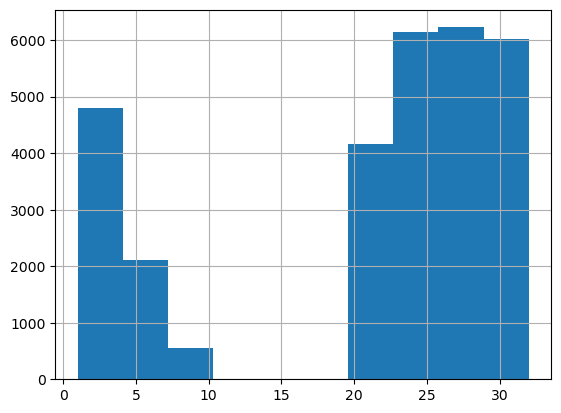

In [ ]:
df_['ask_volume_1'].hist()

In [16]:
import pickle
import json

with open('optimize_naive/optimize0.json', 'w') as f:
    json.dump(opt, f, default=str)

In [60]:
spread_market = pd.DataFrame({'timestamp': df_synthetic['timestamp'].to_numpy(), 'spread_z': z_score, 'swmid': df_PICNIC_BASKET1 ['swmid'].to_numpy() - df_synthetic['swmid'].to_numpy()})

In [62]:
print(f"Mean: {np.mean(spread_market['swmid'].to_numpy())}")
print(f"Std: {np.std(spread_market['swmid'].to_numpy())}")


Mean: 376.1033630150305
Std: 76.3633776067342


In [50]:
opt.sort(key=lambda x: x['pnl'][0], reverse=True)
top_3_pnl = opt[:3]
pnl_graph = top_3_pnl[0]['pnl'][1]

fig = go.Figure()
fig.add_trace(go.Scatter(x=spread_market.index, y=pnl_graph, mode='lines', name='PnL'))
fig.show()


In [29]:
thresh1 = 1.24
thresh2 = 3
position1 = 40
position2 = 40
backtest_pnl_day1, backtest_pnl_hist_day1 = backtest(thresh1, thresh2, position1, position2)
print(f"Backtest PnL: {backtest_pnl_day1}")


Backtest PnL: 35709.84365945391


In [37]:
short_hl = 20
long_hl = 200
diff = pd.DataFrame({"timestamp": df_synthetic['timestamp'], "diff": df_PICNIC_BASKET1 ['swmid'].to_numpy() - df_synthetic['swmid'].to_numpy() - 380})

diff['swmid'] = df_PICNIC_BASKET1 ['swmid'].to_numpy()
diff['short_ewma'] = diff['diff'].ewm(halflife=short_hl, adjust=False).mean()
diff['long_ewma'] = diff['diff'].ewm(halflife=long_hl, adjust=False).mean()

fig = go.Figure()
fig.add_trace(go.Scatter(x=diff['timestamp'], y=diff['diff'], mode='lines', name='Difference', line=dict(color='red')))

fig.add_trace(go.Scatter(x=diff['timestamp'], y=diff['short_ewma'], mode='lines', name='Short EWMA', line=dict(color='blue')))
fig.add_trace(go.Scatter(x=diff['timestamp'], y=diff['long_ewma'], mode='lines', name='Long EWMA', line=dict(color='green')))

fig.show()


In [33]:

ratio = pd.DataFrame({"timestamp": df_synthetic['timestamp'], "ratio": df_PICNIC_BASKET1 ['swmid'].to_numpy()/df_synthetic['swmid'].to_numpy(), "swmid": df_PICNIC_BASKET1 ['swmid'].to_numpy() - df_synthetic['swmid'].to_numpy()})
ratio['ratio_z'] = (ratio['ratio'] - ratio['ratio'].mean()) / ratio['ratio'].std()

fig = go.Figure()
fig.add_trace(go.Scatter(x=ratio['timestamp'], y=ratio['ratio_z'], mode='lines', name='Ratio Z Score', line=dict(color='blue')))
fig.show()



In [3]:
price_diff = diff['diff'].to_numpy()
z_score = (price_diff - np.mean(price_diff)) / np.std(price_diff)
fig = go.Figure()
fig.add_trace(go.Scatter(x=diff['timestamp'], y=z_score, mode='lines', name='Z-Score'))
fig.update_layout(title='Z-Score', xaxis_title='Timestamp', yaxis_title='Z-Score')
fig.show()

In [43]:
from sklearn.linear_model import LinearRegression
import statsmodels.api as sm
gift = df_PICNIC_BASKET1 ['swmid'].to_numpy()
synth = df_synthetic['swmid'].to_numpy()
X = sm.add_constant(synth)
results = sm.OLS(gift, X).fit()
results.params


array([-1.52246156e+04,  1.22011521e+00])

In [58]:
window = 500
diff = pd.DataFrame({'diff': df_PICNIC_BASKET1 ['swmid'].to_numpy() - df_synthetic['swmid'].to_numpy()})
rolling_z_score = (diff['diff'] - diff['diff'].rolling(window=window).mean()) / diff['diff'].rolling(window=window).std()
z_score_diff = (diff['diff'] - np.mean(diff['diff'])) / np.std(diff['diff'])

fig = px.line(x=df_synthetic['timestamp'], y=z_score_diff, title='Difference and Z-Score')
fig.add_scatter(x=df_synthetic['timestamp'], y=rolling_z_score, yaxis="y2")
fig.update_layout(yaxis2=dict(overlaying='y', side='right'))
fig.show()




In [63]:
long_window = 200
ratio = pd.DataFrame({'ratio': df_PICNIC_BASKET1 ['swmid'].to_numpy()/df_synthetic['swmid'].to_numpy()})
ratios_mavg5 = ratio['ratio'].rolling(window=5,
                               center=False).mean()
ratios_mavg_long = ratio['ratio'].rolling(window=long_window,
                               center=False).mean()
std_long = ratio['ratio'].rolling(window=long_window,
                        center=False).std()
zscore_long = (ratios_mavg5 - ratios_mavg_long)/std_long

fig = px.line(zscore_long)
fig.add_scatter(x=ratios_mavg5.index, y=ratios_mavg5, yaxis="y2")
fig.update_layout(yaxis2=dict(overlaying='y', side='right'))
fig.show()


In [64]:
fig = px.line(ratio, x=ratio.index, y='ratio', title='Ratio')
fig.show()


In [6]:
from lib import parse_log_file
import numpy as np
import json
import pandas as pd
df, df_trades, _ = parse_log_file("./clean_log/trade_history_day_0.log")
df_trades = pd.DataFrame(json.loads(df_trades))
df_CROISSANTS = df[df['product'] == 'CROISSANTS'].copy()
df_JAMS = df[df['product'] == 'JAMS'].copy()
df_DJEMBES = df[df['product'] == 'DJEMBES'].copy()
df_PICNIC_BASKET1  = df[df['product'] == 'PICNIC_BASKET1 '].copy()
df_CROISSANTS['swmid'] = (df_CROISSANTS['bid_price_1'] * df_CROISSANTS['ask_volume_1'] + df_CROISSANTS['ask_price_1'] * df_CROISSANTS['bid_volume_1']) / (df_CROISSANTS['ask_volume_1'] + df_CROISSANTS['bid_volume_1'])
df_JAMS['swmid'] = (df_JAMS['bid_price_1'] * df_JAMS['ask_volume_1'] + df_JAMS['ask_price_1'] * df_JAMS['bid_volume_1']) / (df_JAMS['ask_volume_1'] + df_JAMS['bid_volume_1'])
df_DJEMBES['swmid'] = (df_DJEMBES['bid_price_1'] * df_DJEMBES['ask_volume_1'] + df_DJEMBES['ask_price_1'] * df_DJEMBES['bid_volume_1']) / (df_DJEMBES['ask_volume_1'] + df_DJEMBES['bid_volume_1'])
df_PICNIC_BASKET1 ['swmid'] = (df_PICNIC_BASKET1 ['bid_price_1'] * df_PICNIC_BASKET1 ['ask_volume_1'] + df_PICNIC_BASKET1 ['ask_price_1'] * df_PICNIC_BASKET1 ['bid_volume_1']) / (df_PICNIC_BASKET1 ['ask_volume_1'] + df_PICNIC_BASKET1 ['bid_volume_1'])
df_synthetic = pd.DataFrame({
    'timestamp': df_CROISSANTS['timestamp'].to_numpy(),
    'bid_price_1': df_CROISSANTS['bid_price_1'].to_numpy() * 4 + df_JAMS['bid_price_1'].to_numpy() * 6 + df_DJEMBES['bid_price_1'].to_numpy(),
    'bid_volume_1': np.min(np.array([df_CROISSANTS['bid_volume_1'].to_numpy(), df_JAMS['bid_volume_1'].to_numpy(), df_DJEMBES['bid_volume_1'].to_numpy()]), axis=0),
    'ask_price_1': df_CROISSANTS['ask_price_1'].to_numpy() * 4 + df_JAMS['ask_price_1'].to_numpy() * 6 + df_DJEMBES['ask_price_1'].to_numpy(),
    'ask_volume_1': np.min(np.array([df_CROISSANTS['ask_volume_1'].to_numpy(), df_JAMS['ask_volume_1'].to_numpy(), df_DJEMBES['ask_volume_1'].to_numpy()]), axis=0),
    'mid_price':  df_CROISSANTS['mid_price'].to_numpy() * 4 + df_JAMS['mid_price'].to_numpy() * 6 + df_DJEMBES['mid_price'].to_numpy(),
    'swmid': df_CROISSANTS['swmid'].to_numpy() * 4 + df_JAMS['swmid'].to_numpy() * 6 + df_DJEMBES['swmid'].to_numpy()
    })
df_basket_trades = df_trades[df_trades['symbol'] == 'PICNIC_BASKET1 ']
df_DJEMBES_trades = df_trades[df_trades['symbol'] == 'DJEMBES']
df_JAMS_trades = df_trades[df_trades['symbol'] == 'JAMS']
df_CROISSANTS_trades = df_trades[df_trades['symbol'] == 'CROISSANTS']



In [5]:
import plotly.express as px
import plotly.graph_objects as go
fig = go.Figure()
fig.add_trace(go.Scatter(x=df_PICNIC_BASKET1 ['timestamp'], y=df_PICNIC_BASKET1 ['swmid'].to_numpy() - df_synthetic['swmid'].to_numpy(), mode='lines', name='Spread'))
# fig.add_trace(go.Scatter(x=df_PICNIC_BASKET1 ['timestamp'], y=df_PICNIC_BASKET1 ['bid_price_1'], yaxis="y2", mode='lines', name='Bid Price 1'))
# fig.add_trace(go.Scatter(x=df_PICNIC_BASKET1 ['timestamp'], y=df_PICNIC_BASKET1 ['bid_price_2'], yaxis="y2", mode='lines', name='Bid Price 2'))

# fig.add_trace(go.Scatter(x=df_PICNIC_BASKET1 ['timestamp'], y=df_PICNIC_BASKET1 ['ask_price_1'], yaxis="y2", mode='lines', name='Ask Price'))

fig.add_scatter(name="Basket Trades", x=df_basket_trades['timestamp'], y=df_basket_trades['price'], yaxis="y2", mode='markers',marker_size=4, hovertemplate='<b>Trade Price: %{y}</b><br><b>Timestamp: %{x}</b><br>Trade Volume: %{text}', text=df_basket_trades['quantity'])
# fig.add_trace(go.Scatter(x=volume.index, y=volume.values, mode='lines', name='Volume', yaxis='y2'))

fig.update_layout(yaxis2=dict(overlaying='y', side='right'))

fig.show()



NameError: name 'volume' is not defined